In [1]:
%load_ext autoreload
%autoreload 2

from toy_model import state_event_model
from toy_model.state_event_generator import *
from toy_model.simple_hamiltonian import SimpleHamiltonian 
from toy_model.utils import plot_solution_comparison, plot_event_2d

from quantum_algorithms.HHL import HHLAlgorithm as hhl
from quantum_algorithms.OneBQF import OneBQF as onebqf

import numpy as np

In [10]:
'''
from qiskit_ibm_runtime import QiskitRuntimeService
QiskitRuntimeService.save_account(
    channel="ibm_cloud",
    token="",  # Get from IBM Cloud dashboard
    url="", # Get from IBM Cloud dashboard
    instance="",  # Get from IBM Cloud dashboard
)
'''

'\nfrom qiskit_ibm_runtime import QiskitRuntimeService\nQiskitRuntimeService.save_account(\n    channel="ibm_cloud",\n    token="",  # Get from IBM Cloud dashboard\n    url="", # Get from IBM Cloud dashboard\n    instance="",  # Get from IBM Cloud dashboard\n)\n'

# Tracking Setup

In [25]:
dz = 20
n_particles = [64]
events = len(n_particles)
layers = 5
n = np.sum(n_particles)

module_id = [l for l in range(1, layers+1)]
lx = [33 for x in range(1, layers+1)]
ly = [33 for x in range(1, layers+1)]
zs = [dz*l for l in range(1, layers+1)]

Detector = state_event_model.PlaneGeometry(module_id=module_id, lx=lx, ly=ly, z=zs)

state_event_gen = StateEventGenerator(Detector, events=len(n_particles), n_particles=n_particles,
                                    measurement_error=0.0, collision_noise=0.00)
state_event_gen.generate_random_primary_vertices({'x': 0, 'y': 0, 'z': 0})

event_particles = []
for event in range(events):
    particles_list = []
    for particle in range(n):
        particle_dict = {'type': 'MIP', 'mass': 0.511, 'q': 1}
        particles_list.append(particle_dict)
    event_particles.append(particles_list)

state_event_gen.generate_particles(event_particles)
event_tracks = state_event_gen.generate_complete_events()
noisy_tracks = state_event_gen.make_noisy_event(drop_rate=0.0, ghost_rate=0.0)

ham = SimpleHamiltonian(epsilon=1e-7, alpha=2.0, beta=1.0)
ham.construct_hamiltonian(event=event_tracks, convolution=False)

(<Compressed Sparse Column sparse matrix of dtype 'float64'
 	with 16768 stored elements and shape (16384, 16384)>,
 array([1., 1., 1., ..., 1., 1., 1.], shape=(16384,)))

In [ ]:
A = ham.A.todense()
matrix_A = A
vector_b = np.ones(len(A))
hhl_solver = onebqf(matrix_A, vector_b, num_time_qubits=1, shots=10000, debug=False)
circuit = hhl_solver.build_circuit()
counts = hhl_solver.run(use_noise_model=False, backend_name=None)
quantum_solution, total_success = hhl_solver.get_solution()

In [12]:
# Example of running on different IBMQ backends with noise models
#counts = hhl_solver.run(use_noise_model=True, backend_name=None) 
# ibm_marrakesh, ibm_torino, ibm_pittsburgh, ibm_fez or any other available backend


# Event Display

In [26]:

#plot_event_2d(event_tracks, Detector, filename='event_full.png', save_to_file=False)

# Hide primary vertex
plot_event_2d(event_tracks, Detector, show_pv=False, filename='event_no_pv.jpeg', save_to_file=False, dpi=600)

# Hide wrong segments (only show true tracks)
# plot_event_2d(event_tracks, Detector, show_wrong_segments=False, filename='event_true_tracks.png', save_to_file=False)

# All segments same color
# plot_event_2d(event_tracks, Detector, uniform_segment_color=True, segment_color='blue', filename='event_uniform.png', save_to_file=False)

# Combination: no PV, no wrong segments
# plot_event_2d(event_tracks, Detector, show_pv=False, show_wrong_segments=False, filename='event_clean.png', save_to_file=False)

# Solution Visualisation

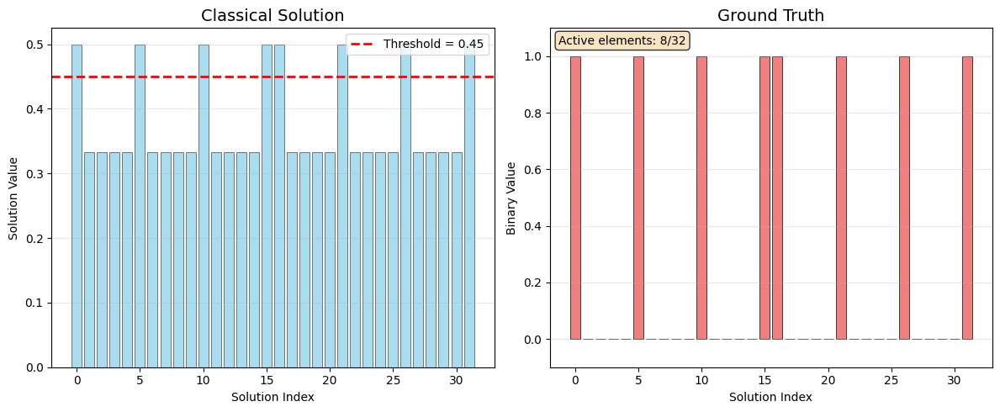

In [14]:
#visualize results
classical_solution = ham.solve_classicaly()
T = .45
discretized_classical_solution = (classical_solution > T).astype(int)
plot_solution_comparison(classical_solution, discretized_classical_solution, threshold=T)

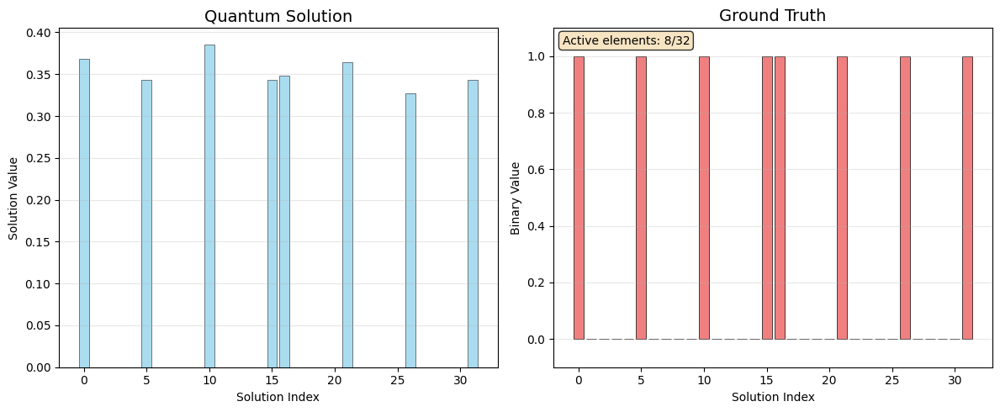

In [15]:
#visualize results
classical_solution = ham.solve_classicaly()
T = .45
discretized_classical_solution = (classical_solution > T).astype(int)
plot_solution_comparison(quantum_solution, discretized_classical_solution, title="Quantum Solution")

In [16]:
nonzero_indices = np.nonzero(discretized_classical_solution)[0]
nonzero_hhl = np.nonzero(quantum_solution)[0]
set1 = set(nonzero_indices)
set2 = set(nonzero_hhl)

print("Solutions match",set1 - set2)

Solutions match set()


# Circuit Stats

In [17]:
circuit_depth = circuit.decompose().decompose().decompose().decompose().decompose().depth()
circuit_statistics = circuit.decompose().decompose().decompose().decompose().decompose().count_ops()
print(f"Circuit Depth: {circuit_depth}")
print(f"Circuit Statistics: {circuit_statistics}")

Circuit Depth: 507
Circuit Statistics: OrderedDict({'u': 365, 'cx': 321, 'u3': 144, 'measure': 6})


In [18]:
print(circuit)

         ┌───┐                                                             »
   time: ┤ H ├──────────■─────────────────────■────────────────■───────────»
         ├───┤┌───┐     │      ┌───┐          │      ┌───┐     │      ┌───┐»
    b_0: ┤ H ├┤ X ├─────■──────┤ X ├──────────■──────┤ X ├─────■──────┤ X ├»
         ├───┤├───┤     │      ├───┤┌───┐     │      ├───┤     │      └───┘»
    b_1: ┤ H ├┤ X ├─────■──────┤ X ├┤ X ├─────■──────┤ X ├─────■───────────»
         ├───┤├───┤     │      ├───┤└───┘     │      ├───┤     │      ┌───┐»
    b_2: ┤ H ├┤ X ├─────■──────┤ X ├──────────■──────┤ X ├─────■──────┤ X ├»
         ├───┤├───┤     │      ├───┤┌───┐     │      ├───┤     │      └───┘»
    b_3: ┤ H ├┤ X ├─────■──────┤ X ├┤ X ├─────■──────┤ X ├─────■───────────»
         ├───┤└───┘┌────┴─────┐└───┘└───┘┌────┴─────┐└───┘┌────┴─────┐     »
    b_4: ┤ H ├─────┤ Rx(2π/3) ├──────────┤ Rx(2π/3) ├─────┤ Rx(2π/3) ├─────»
         └───┘     └──────────┘          └──────────┘     └──────────┘     »

# TKET Translation

In [20]:
from pytket.extensions.qiskit import qiskit_to_tk
from pytket.passes import FullPeepholeOptimise
from pytket.utils import gate_counts
from IPython.display import display

In [21]:
#Do not run with big circuits - may take too long
decomposed_circuit = circuit.decompose().decompose().decompose().decompose().decompose()
circuit_tk = qiskit_to_tk(decomposed_circuit)
FullPeepholeOptimise().apply(circuit_tk)
print("Gates:" ,gate_counts(circuit_tk))
print("Depth:" ,circuit_tk.depth())

Gates: Counter({OpType.CX: 321, OpType.TK1: 310, OpType.Measure: 6})
Depth: 439


In [23]:
from pytket.extensions.offline_display import get_circuit_renderer
from IPython.display import display, HTML

circuit_renderer = get_circuit_renderer()
circuit_renderer.config.min_height = "600px"

rendered = circuit_renderer.render_circuit_jupyter(circuit_tk)
display(rendered)

None